In [4]:
import ipdb
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.pylab as pylab
import cartopy
import cartopy.crs as ccrs
from utils import constants as cnst
from eod import msg
from utils import u_grid, u_interpolate as u_int, u_darrays as uda
import datetime
import salem
from salem import get_demo_file, DataLevels, GoogleVisibleMap, Map
import shapely.geometry as shpg
import glob
import matplotlib.patches as patches


pylab.rcParams['figure.figsize'] = (50., 50.)
%matplotlib inline

In [3]:
cd ..

/home/ck/pythonWorkspace


In [5]:
glob.glob('/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/*_2*.nc')

['/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/ERA5_monthly_0.7deg_2000.nc',
 '/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/ERA5_monthly_0.7deg_2001.nc',
 '/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/ERA5_monthly_0.7deg_2002.nc',
 '/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/ERA5_monthly_0.7deg_2003.nc',
 '/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/ERA5_monthly_0.7deg_2004.nc',
 '/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/ERA5_monthly_0.7deg_2005.nc',
 '/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/ERA5_monthly_0.7deg_2006.nc',
 '/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/ERA5_monthly_0.7deg_2007.nc',
 '/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/ERA5_monthly_0.7deg_2008.nc',
 '/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/ERA5_month

In [6]:
era = xr.open_mfdataset(glob.glob('/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/*_2*.nc'))
era = uda.flip_lat(era)

In [7]:
erapl = xr.open_mfdataset(glob.glob('/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/pressure_levels/*_2*.nc'))
erapl = uda.flip_lat(erapl)

In [8]:
erapl_seas = erapl.groupby('time.season').mean('time').sel(latitude=slice(-46,49), longitude=slice(-120,150))
era_seas = era.groupby('time.season').mean('time').sel(latitude=slice(-46,49), longitude=slice(-120,150))

In [9]:
erapl_all = erapl.mean('time').sel(latitude=slice(-46,49), longitude=slice(-120,150))
era_all = era.mean('time').sel(latitude=slice(-46,49), longitude=slice(-120,150)) #sel(time=((erapl['time.month']>=5) & (erapl['time.month']<=10)))itude=slice(-120,150))

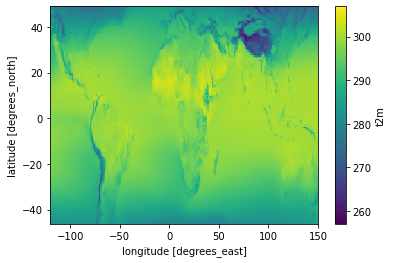

In [10]:
era_seas['t2m'].mean('season').plot()

In [11]:
era_seas

<xarray.Dataset>
Dimensions:    (latitude: 136, longitude: 386, season: 4)
Coordinates:
  * longitude  (longitude) float32 -119.8 -119.1 -118.4 ... 148.3 149.0 149.7
  * latitude   (latitude) float32 -45.9 -45.2 -44.5 -43.8 ... 47.2 47.9 48.6
  * season     (season) object 'DJF' 'JJA' 'MAM' 'SON'
Data variables:
    u100       (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    v100       (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    u10        (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    v10        (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    d2m        (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    t2m        (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    blh        (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    cape       (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    msl        (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    sst        (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    slhf       (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    sp         (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    sshf       (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    tcwv       (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    tp         (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    vimd       (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    swvl1      (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>
    swvl4      (season, latitude, longitude) float32 dask.array<chunksize=(1, 136, 386), meta=np.ndarray>

In [12]:
erapl_seas

<xarray.Dataset>
Dimensions:    (latitude: 136, level: 5, longitude: 386, season: 4)
Coordinates:
  * longitude  (longitude) float32 -119.8 -119.1 -118.4 ... 148.3 149.0 149.7
  * latitude   (latitude) float32 -45.9 -45.2 -44.5 -43.8 ... 47.2 47.9 48.6
  * level      (level) int32 200 500 650 850 925
  * season     (season) object 'DJF' 'JJA' 'MAM' 'SON'
Data variables:
    u          (season, level, latitude, longitude) float32 dask.array<chunksize=(1, 5, 136, 386), meta=np.ndarray>
    v          (season, level, latitude, longitude) float32 dask.array<chunksize=(1, 5, 136, 386), meta=np.ndarray>
    z          (season, level, latitude, longitude) float32 dask.array<chunksize=(1, 5, 136, 386), meta=np.ndarray>
    t          (season, level, latitude, longitude) float32 dask.array<chunksize=(1, 5, 136, 386), meta=np.ndarray>
    q          (season, level, latitude, longitude) float32 dask.array<chunksize=(1, 5, 136, 386), meta=np.ndarray>

In [13]:
def map_2d(ax, ds, dp, da, cmap=None, clabel=None):    
    
    ax.set_facecolor('xkcd:grey') #lightgrey
    ax.coastlines()
    xl = ax.gridlines(draw_labels=True);
    xl.top_labels = False
    xl.right_labels = True
    # Countries
    ax.add_feature(cartopy.feature.BORDERS, linestyle='--', linewidth=0.5);
    
    u850 = dp['u'].sel(level=850)
    v850 = dp['v'].sel(level=850)
    
    u500 = dp['u'].sel(level=500)
    v500 = dp['v'].sel(level=500)
    
    ua850 = da['u'].sel(level=850)
    va850 = da['v'].sel(level=850)
    
    ua500 = da['u'].sel(level=500)
    va500 = da['v'].sel(level=500)
    
    
    u = (u500-u850) #-(ua500-ua850)
    v = (v500-v850) #-(va500-va850)
    
    st=2
    stt = 5
    sarrow = 1
    xquiv = u.longitude[sarrow::stt]
    yquiv = u.latitude[sarrow::stt]
    
    uu = u[sarrow::stt,sarrow::stt]
    vv = v[sarrow::stt, sarrow::stt]
    
    #ipdb.set_trace()
    
    cf = plt.contourf(ds.longitude, ds.latitude, ds, transform=ccrs.PlateCarree(), extend='both', levels=np.linspace(np.percentile(ds,2),np.percentile(ds,98),20), cmap=cmap, alpha=0.8)
    #plt.contourf(mapswet.longitude, mapsdry.latitude, (mapswetq-mapsdryq).where((qmask), other=0)*1000 ,levels=np.linspace(-0.5,0.51,20),cmap='RdBu', transform=ccrs.PlateCarree(), extend='both', alpha=0.8)

    cb = plt.colorbar(cf, label=clabel, format='%1.1f')
    cf = plt.contour(ds.longitude, ds.latitude, ds, transform=ccrs.PlateCarree(), extend='both', levels=np.linspace(np.percentile(ds,2),np.percentile(ds,98),20), linewidths=0.1, colors='k')
#     plt.contour(tirwet.longitude, tirwet.latitude, (tirwet-tirdry), levels=[30,50], colors=['k'] , transform=ccrs.PlateCarree(), extend='both', linewidths=1.2)
    #cb.remove()
 
    qv = plt.quiver(xquiv, yquiv, uu, vv, scale=400, width=0.0005, headwidth=7)
    qk = plt.quiverkey(qv, 0.9, 0.97, 2, r'$2 \frac{m}{s}$', labelpos='E',
                   coordinates='figure')

In [14]:
def map_2d_100m(ax, ds, dp, cmap=None, var='t2m', clabel=None):    
    
    ax.set_facecolor('xkcd:grey') #lightgrey
    ax.coastlines()
    xl = ax.gridlines(draw_labels=True);
    xl.top_labels = False
    xl.right_labels = True
    # Countries
    ax.add_feature(cartopy.feature.BORDERS, linestyle='--', linewidth=0.5);
    
    u = ds['u100']
    v = ds['v100']
    
    st=2
    stt = 5
    sarrow = 1
    xquiv = u.longitude[sarrow::stt]
    yquiv = u.latitude[sarrow::stt]
    
    uu = u[sarrow::stt,sarrow::stt]
    vv = v[sarrow::stt, sarrow::stt]
    
    #ipdb.set_trace()
    
    cf = plt.contourf(ds.longitude, ds.latitude, ds[var], transform=ccrs.PlateCarree(), extend='both', levels=np.linspace(np.percentile(ds[var],2),np.percentile(ds[var],98),20), cmap=cmap, alpha=0.8)
    
    
    #plt.contourf(mapswet.longitude, mapsdry.latitude, (mapswetq-mapsdryq).where((qmask), other=0)*1000 ,levels=np.linspace(-0.5,0.51,20),cmap='RdBu', transform=ccrs.PlateCarree(), extend='both', alpha=0.8)

    cb = plt.colorbar(cf, label=clabel, format='%1.1f')
    cf = plt.contour(ds.longitude, ds.latitude, ds[var], transform=ccrs.PlateCarree(), extend='both', levels=np.linspace(np.percentile(ds[var],2),np.percentile(ds[var],98),20), linewidths=0.1, colors='k')
#     plt.contour(tirwet.longitude, tirwet.latitude, (tirwet-tirdry), levels=[30,50], colors=['k'] , transform=ccrs.PlateCarree(), extend='both', linewidths=1.2)
    #cb.remove()
 
    qv = plt.quiver(xquiv, yquiv, uu, vv, scale=300, width=0.0005, headwidth=7)
    qk = plt.quiverkey(qv, 0.9, 0.97, 2, r'$2 \frac{m}{s}$', labelpos='E',
                   coordinates='figure')

FileNotFoundError: [Errno 2] No such file or directory: '/home/ck/DIR/cornkle/figs/GLOBAL_MCS/JJA_overview.jpg'

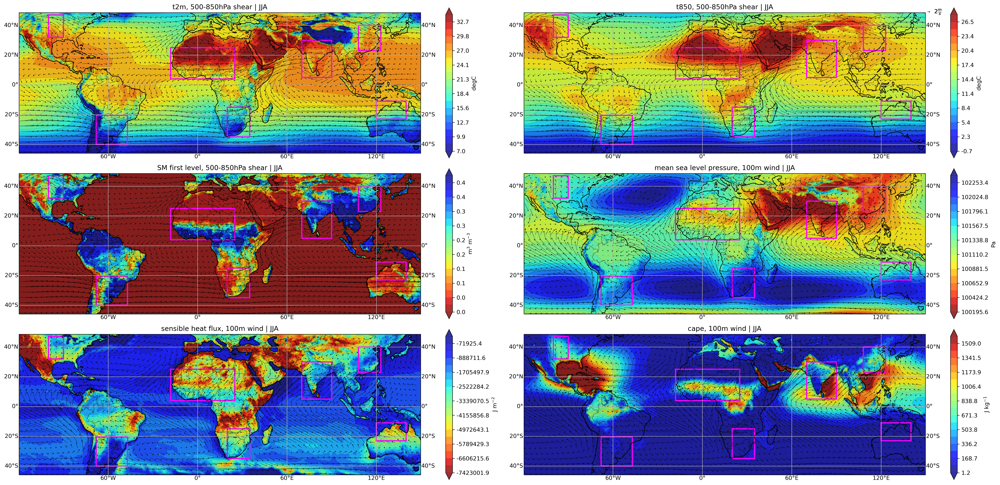

In [15]:
seas = 'JJA'
ecolor='fuchsia'

mregions = {'WAf' : [[-18,25,4,25], 'spac', 0], # last is hourly offset to UCT # 12
 'SAf' : [[20,35, -35,-15], 'spac', 2], # 10
 'india' : [[70,90, 5,30], 'asia', 5], # 7
 'china' : [[108,123,23,40], 'asia', 8 ], # 4
 'australia' : [[120,140,-23, -11], 'asia', 9], # 3
 'sub_SA' : [[-68,-47, -40, -20.5], 'spac', -4] , # 16
 #'trop_SA' : [[-75, -50, -20, -5], 'spac', -5], # 17
 'GPlains' : [[-100,-90,32,47], 'nam', -6] }# # 18
 #'EAf'     : [[33,52,-5,15],'spac', 3 ] }

f = plt.figure(figsize=(25,12), dpi=300)
ax = f.add_subplot(321, projection=ccrs.PlateCarree())
map_2d(ax, era_seas['t2m'].sel(season=seas).squeeze()-273.15, erapl_seas.sel(season=seas).squeeze(), erapl_all, clabel='degC', cmap='jet')
#map_2d(ax, erapl_seas['t'].sel(season=seas, level=1000).squeeze(), erapl_seas.sel(season=seas).squeeze())            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('t2m, 500-850hPa shear | '+seas)


ax = f.add_subplot(322, projection=ccrs.PlateCarree())
map_2d(ax, erapl_seas['t'].sel(season=seas, level=850).squeeze()-273.15, erapl_seas.sel(season=seas).squeeze(),  erapl_all,clabel='degC', cmap='jet')
#map_2d(ax, erapl_seas['t'].sel(season=seas, level=1000).squeeze(), erapl_seas.sel(season=seas).squeeze())            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('t850, 500-850hPa shear | '+seas)



ax = f.add_subplot(323, projection=ccrs.PlateCarree())
map_2d(ax, (era_seas['swvl1'].sel(season=seas).squeeze()), erapl_seas.sel(season=seas).squeeze(),  erapl_all, cmap='jet_r', clabel=r'm$^{3}$ m$^{-3}$')
            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('SM first level, 500-850hPa shear | '+seas)

##################################################

ax = f.add_subplot(324, projection=ccrs.PlateCarree())
map_2d_100m(ax, era_seas.sel(season=seas), erapl_seas.sel(season=seas), var='msl', clabel='Pa', cmap='jet_r')
#map_2d(ax, erapl_seas['t'].sel(season=seas, level=1000).squeeze(), erapl_seas.sel(season=seas).squeeze())            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('mean sea level pressure, 100m wind | '+seas)


ax = f.add_subplot(325, projection=ccrs.PlateCarree())
map_2d_100m(ax, era_seas.sel(season=seas), erapl_seas.sel(season=seas), var='sshf', clabel='J m$^{-2}$', cmap='jet_r')
#map_2d(ax, erapl_seas['t'].sel(season=seas, level=1000).squeeze(), erapl_seas.sel(season=seas).squeeze())            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('sensible heat flux, 100m wind | '+seas)



ax = f.add_subplot(326, projection=ccrs.PlateCarree())
map_2d_100m(ax, (era_seas.sel(season=seas)), erapl_seas.sel(season=seas), var='cape', clabel='J kg$^{-1}$', cmap='jet')
            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('cape, 100m wind | '+seas)
#plt.tight_layout()


plt.tight_layout()
f = f.savefig('/home/ck/DIR/cornkle/figs/GLOBAL_MCS/JJA_overview.jpg')

In [ ]:
seas = 'DJF'
ecolor='fuchsia'

mregions = {'WAf' : [[-18,25,4,25], 'spac', 0], # last is hourly offset to UCT # 12
 'SAf' : [[20,35, -35,-15], 'spac', 2], # 10
 'india' : [[70,90, 5,30], 'asia', 5], # 7
 'china' : [[108,123,23,40], 'asia', 8 ], # 4
 'australia' : [[120,140,-23, -11], 'asia', 9], # 3
 'sub_SA' : [[-68,-47, -40, -20.5], 'spac', -4] , # 16
 #'trop_SA' : [[-75, -50, -20, -5], 'spac', -5], # 17
 'GPlains' : [[-100,-90,32,47], 'nam', -6] }# # 18
 #'EAf'     : [[33,52,-5,15],'spac', 3 ] }

f = plt.figure(figsize=(25,12), dpi=300)
ax = f.add_subplot(321, projection=ccrs.PlateCarree())
map_2d(ax, era_seas['t2m'].sel(season=seas).squeeze()-273.15, erapl_seas.sel(season=seas).squeeze(), erapl_all, clabel='degC', cmap='jet')
#map_2d(ax, erapl_seas['t'].sel(season=seas, level=1000).squeeze(), erapl_seas.sel(season=seas).squeeze())            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('t2m, 500-850hPa shear | '+seas)


ax = f.add_subplot(322, projection=ccrs.PlateCarree())
map_2d(ax, erapl_seas['t'].sel(season=seas, level=850).squeeze()-273.15, erapl_seas.sel(season=seas).squeeze(),  erapl_all,clabel='degC', cmap='jet')
#map_2d(ax, erapl_seas['t'].sel(season=seas, level=1000).squeeze(), erapl_seas.sel(season=seas).squeeze())            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('t850, 500-850hPa shear | '+seas)



ax = f.add_subplot(323, projection=ccrs.PlateCarree())
map_2d(ax, (era_seas['swvl1'].sel(season=seas).squeeze()), erapl_seas.sel(season=seas).squeeze(),  erapl_all, cmap='jet_r', clabel=r'm$^{3}$ m$^{-3}$')
            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('SM first level, 500-850hPa shear | '+seas)

##################################################

ax = f.add_subplot(324, projection=ccrs.PlateCarree())
map_2d_100m(ax, era_seas.sel(season=seas), erapl_seas.sel(season=seas), var='msl', clabel='Pa', cmap='jet_r')
#map_2d(ax, erapl_seas['t'].sel(season=seas, level=1000).squeeze(), erapl_seas.sel(season=seas).squeeze())            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('mean sea level pressure, 100m wind | '+seas)


ax = f.add_subplot(325, projection=ccrs.PlateCarree())
map_2d_100m(ax, era_seas.sel(season=seas), erapl_seas.sel(season=seas), var='sshf', clabel='J m$^{-2}$', cmap='jet_r')
#map_2d(ax, erapl_seas['t'].sel(season=seas, level=1000).squeeze(), erapl_seas.sel(season=seas).squeeze())            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('sensible heat flux, 100m wind | '+seas)



ax = f.add_subplot(326, projection=ccrs.PlateCarree())
map_2d_100m(ax, (era_seas.sel(season=seas)), erapl_seas.sel(season=seas), var='cape', clabel='J kg$^{-1}$', cmap='jet')
            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('cape, 100m wind | '+seas)
#plt.tight_layout()


plt.tight_layout()
f = f.savefig('/home/ck/DIR/cornkle/figs/GLOBAL_MCS/DJF_overview.jpg')

Text(0.5, 1.0, 'SM-l1, JJA')

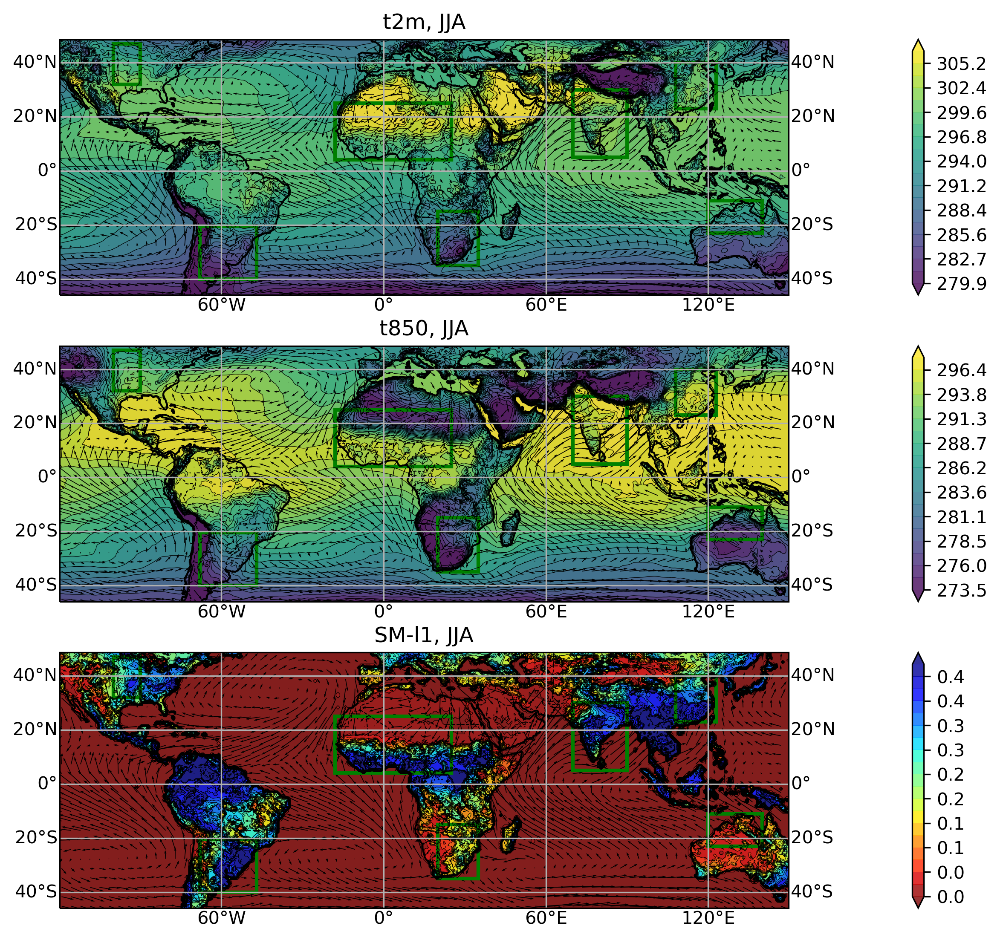

In [46]:
seas = 'JJA'

mregions = {'WAf' : [[-18,25,4,25], 'spac', 0], # last is hourly offset to UCT # 12
 'SAf' : [[20,35, -35,-15], 'spac', 2], # 10
 'india' : [[70,90, 5,30], 'asia', 5], # 7
 'china' : [[108,123,23,40], 'asia', 8 ], # 4
 'australia' : [[120,140,-23, -11], 'asia', 9], # 3
 'sub_SA' : [[-68,-47, -40, -20.5], 'spac', -4] , # 16
 #'trop_SA' : [[-75, -50, -20, -5], 'spac', -5], # 17
 'GPlains' : [[-100,-90,32,47], 'nam', -6] }# # 18
 #'EAf'     : [[33,52,-5,15],'spac', 3 ] }

f = plt.figure(figsize=(25,9), dpi=300)
ax = f.add_subplot(311, projection=ccrs.PlateCarree())
map_2d_100m(ax, era_seas.sel(season=seas), erapl_seas.sel(season=seas), var='t2m')
#map_2d(ax, erapl_seas['t'].sel(season=seas, level=1000).squeeze(), erapl_seas.sel(season=seas).squeeze())            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='green', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('t2m, '+seas)


ax = f.add_subplot(312, projection=ccrs.PlateCarree())
map_2d_100m(ax, era_seas.sel(season=seas), erapl_seas.sel(season=seas), var='d2m')
#map_2d(ax, erapl_seas['t'].sel(season=seas, level=1000).squeeze(), erapl_seas.sel(season=seas).squeeze())            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='green', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('t850, '+seas)



ax = f.add_subplot(313, projection=ccrs.PlateCarree())
map_2d_100m(ax, (era_seas.sel(season=seas)), erapl_seas.sel(season=seas), cmap='jet_r', var='swvl1')
            
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='green', facecolor='none', transform=ax.transData)

    # Add the patch to the Axes
    ax.add_patch(rect)
#ax.set_ylim(-10,50)
plt.title('SM-l1, '+seas)
#plt.tight_layout()

In [13]:
tag = 'satellite'
g = GoogleVisibleMap(x=[-50, 100], y=[-40, 30], #[-80, 140], y=[-40, 30]
                     scale=4,  # scale is for more details
                     maptype=tag)  # try out also: 'terrain'

Text(0.5, 1.0, 'Google static map')

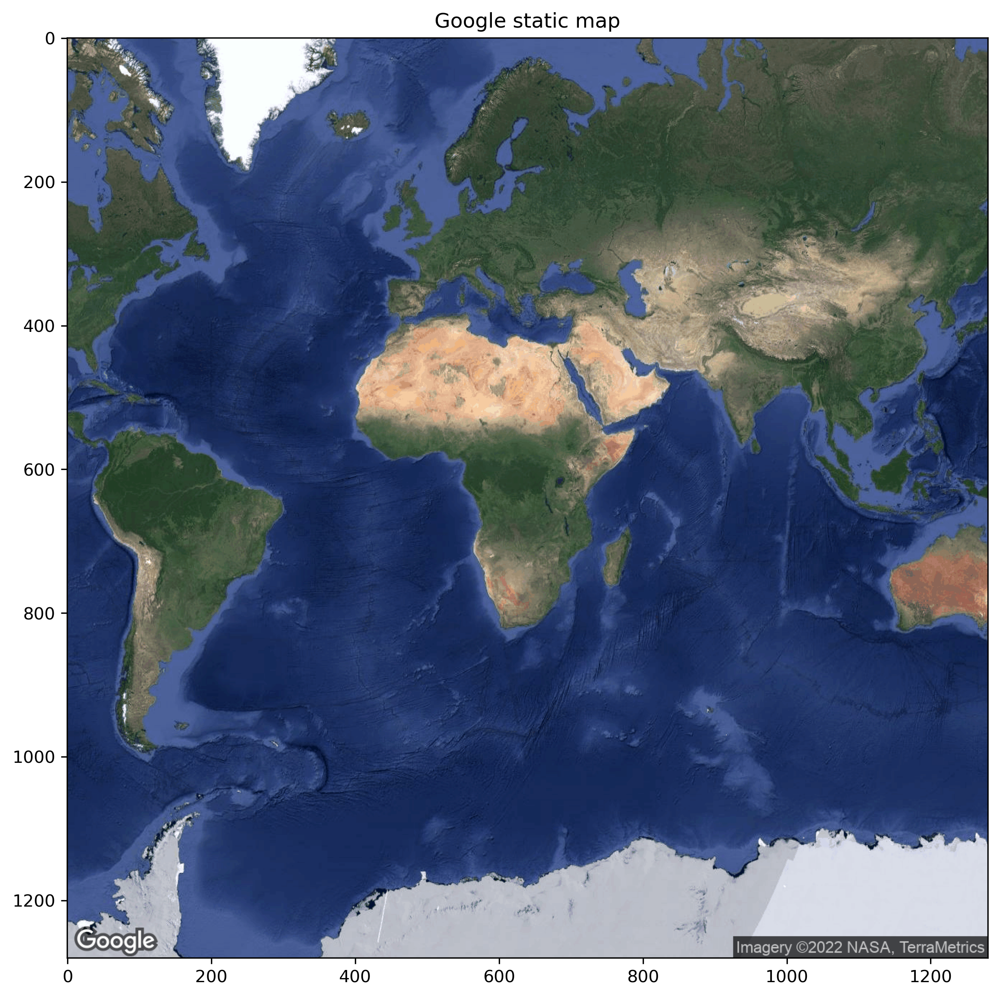

In [14]:
f = plt.figure(figsize=(15,10), dpi=300)
ax1 = f.add_subplot(111)
# the google static image is a standard rgb image
ggl_img = g.get_vardata()
ax1.imshow(ggl_img)

ax1.set_title('Google static map')


In [15]:
g.set_subset(corners=[(-105,-45),(142,50)])
ggl_img = g.get_vardata()

/home/ck/miniconda3/lib/python3.7/site-packages/salem/datasets.py:171: RuntimeWarning: x0 out of bounds
  warnings.warn('x0 out of bounds', RuntimeWarning)


In [16]:
g.grid

<salem.Grid>
  proj: +a=6378137 +b=6378137 +k=1 +lat_ts=0 +lon_0=0 +nadgrids=@null +no_defs+proj=merc +units=m +wktext +x_0=0 +y_0=0
  pixel_ref: center
  origin: upper-left
  (nx, ny): (2560, 1234)
  (dx, dy): (9783.93962050256, -9783.93962050256)
  (x0, y0): (-9740455.444411438, 6447995.511005256)

ValueError: Dimensions of data do not match the map.

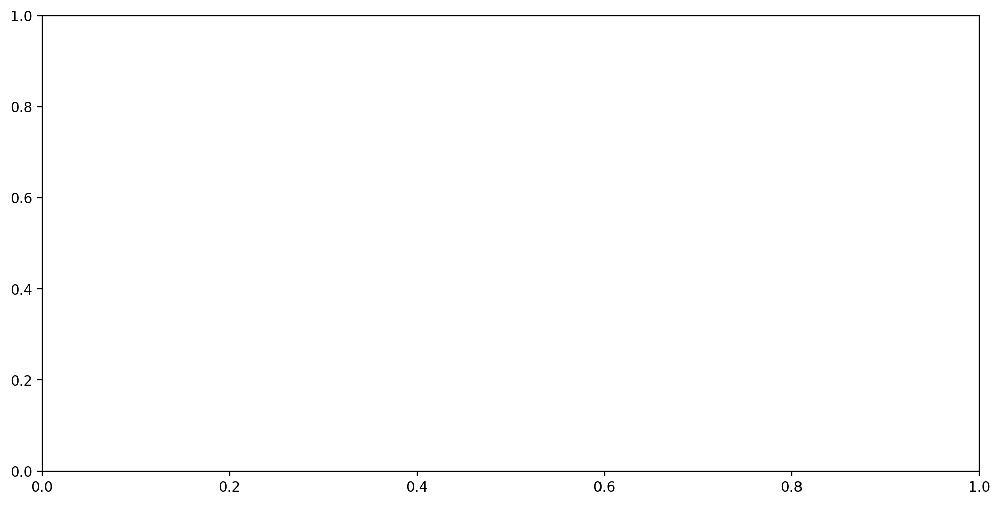

In [17]:
regions = {
    'india' : ([70,90, 5,30], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b') , ("o", 'b'), ("", 'g'), 'g', '', 'india'),
    'india_cptp' : ([70,90, 25,30], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b') , ("o", 'b'), ("", 'g'), '', 'fu', 'Northern India'),
    #'cptp' : ([70,115,25,40], 'blue', 'dashed', 2, ('o', 'k')),
    'china' : ([105,115,25,40], 'k', 'solid', 0.8, ("^", 'g') , ("", 'b') , ("o", 'b'), ("", 'g'), 'h', 'fu', 'china'),
    'australia' : ([120,140,-23, -11], 'k', 'solid', 0.8, ('', 'k'), ("v", 'b') , ("", 'b'), ("X", 'g'), 'i', '', 'australia'),
    'sa' : ([20,35, -35,-15], 'k', 'solid', 0.8, ('', 'k'), ("v", 'b'),  ("", 'b'), ("P", 'g'), 'f' , 'fu', 'SAf'),
#     'sub_ssa_p' : ([-68,-47, -40, -20.5], 'purple', 'solid', 1.5, ('', 'k'), ("v", 'b') ,  ("", 'b'), ("X", 'b'), 'e', 'fu'),
#     'trop_ssa_p' : ([-75, -50, -20, -5], 'purple', 'solid', 1.5, ('', 'g'), ("v", 'b'), ("", 'b') , ("X", 'g'), 'd', 'fu'),
    'sub_ssa' : ([-68,-47, -40, -20.5], 'k', 'solid', 0.8, ('', 'k'), ("v", 'b') ,  ("", 'b'), ("X", 'b'), 'b', 'fu', 'sub_SA'),
   # 'trop_ssa' : ([-75, -50, -20, -5], 'k', 'solid', 0.8, ('', 'g'), ("v", 'b'), ("", 'b') , ("X", 'g'), 'a', 'fu', 'Tropical South America'),
    'sahel' : ([-18,25,4,25], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("", 'b') , ("P", 'g'), 'd', 'fu', 'WAf'),
    'GPlains' : ([-100,-90,32,47], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("", 'b') , ("X", 'g'), 'c', 'fu', 'GPlains'),
  #  'congo' : ([9, 35, -10, 9], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("v", 'b') , ("", 'g'), 'e', 'fu', 'Central Africa')
    }


f = plt.figure(figsize=(12,6), dpi=200)
ax1 = f.add_subplot(111)
# make a map of the same size as the image (no country borders)



sm = Map(g.grid, factor=1)
# Change the country borders
sm.set_shapefile()
sm.set_shapefile(countries=True, color='grey', linewidths=0.05)

# Change the lon-lat countour setting
sm.set_lonlat_contours()
sm.set_lonlat_contours( interval=20, linewidths=0.5,
                         linestyles='dashed', colors='grey')

sm.set_rgb(ggl_img)  # add the background rgb image
sm.set_scale_bar(location=(0.88, 0.94))  # add scale
if tag == 'terrain':
    ec = 'k'
else:
    ec = 'w'
for reg in regions.keys():
        #sm.set_geometry()
        coord = (regions[reg])[0]
        #ipdb.set_trace()
        geom = shpg.box(coord[0], coord[2], coord[1], coord[3])
        if (reg == 'india_cptp') | (reg=='china'):
            edc = 'orange'
        else:
            edc = (regions[reg])[1]
        sm.set_geometry(geom, zorder=99, facecolor=None,edgecolor=edc, linewidth=(regions[reg])[3], linestyle=(regions[reg])[2], alpha=0.1) 
        
        x, y = sm.grid.transform(coord[0]-3, coord[3]-2)
        plt.text(x,y,(regions[reg])[8], fontweight='bold', color='red')

        points = (regions[reg])[4]
        x, y = sm.grid.transform(coord[0]+2, coord[3]-2)
        plt.scatter(x, y, color=points[1],marker=points[0], s=25, edgecolor=ec, linewidth=0.2)
        
        points = (regions[reg])[5]
        x, y = sm.grid.transform(coord[0]+3, coord[3]-2)
        plt.scatter(x, y, color=points[1],marker=points[0], s=25, edgecolor=ec, linewidth=0.2)
        
        points = (regions[reg])[6]
        x, y = sm.grid.transform(coord[0]+4.5, coord[3]-2)
        plt.scatter(x, y, color=points[1],marker=points[0], s=25, edgecolor=ec, linewidth=0.2)
        
        points = (regions[reg])[7]
        x, y = sm.grid.transform(coord[0]+6.5, coord[3]-2)
        plt.scatter(x, y, color=points[1],marker=points[0], s=25, edgecolor=ec, linewidth=0.2)

   
boxed = shpg.box(60, -36, 110, -11)
sm.set_geometry(boxed, facecolor='white',edgecolor='white', color='white', fill=True, zorder=98)
        
lon,lat = 63, -12.5
x, y = sm.grid.transform(lon, lat)
plt.plot(x,y,color='k', marker='^', zorder=99)
x, y = sm.grid.transform(lon+1.5, lat-1)
plt.text(x+2, y-2.5, 'DYAMOND Summer (40 days global)', fontsize=7, zorder=99)

lon,lat = 63, -16
x, y = sm.grid.transform(lon, lat)
plt.plot(x,y,color='k', marker='v', zorder=99)
x, y = sm.grid.transform(lon+1.5, lat-1)
plt.text(x+2, y-2.5, 'DYAMOND Winter (40 days global)', fontsize=7, zorder=99)

lon,lat = 63, -19.5
x, y = sm.grid.transform(lon, lat)
plt.plot(x,y,color='k', marker='o', zorder=99)
x, y = sm.grid.transform(lon+1.5, lat-1)
plt.text(x+2, y-2.5, 'CPTP (2-10 years historical[+future])', fontsize=7, zorder=99)

lon,lat = 63, -23
x, y = sm.grid.transform(lon, lat)
plt.plot(x,y,color='k', marker='x', zorder=99)
x, y = sm.grid.transform(lon+1.5, lat-1)
plt.text(x+2, y-2.5, '(W)CSSP / Other [partners]', fontsize=7, zorder=99)


lon,lat = 63, -26.5
x, y = sm.grid.transform(lon, lat)
#plt.plot(x,y,color='k', marker='x', zorder=99)
x, y = sm.grid.transform(lon+1.5, lat-1)
plt.text(x+2, y-2.5, 'ICON GLOBAL - 5km/1year', fontsize=7, zorder=99, color='k')


lon,lat = 63, -29.5
x, y = sm.grid.transform(lon, lat)
#plt.plot(x,y,color='k', marker='x', zorder=99)
x, y = sm.grid.transform(lon+1.5, lat-1)
plt.text(x+2, y-2.5, 'Available', fontsize=7, zorder=99, color='g')

lon,lat = 63, -33
x, y = sm.grid.transform(lon, lat)
#plt.plot(x,y,color='k', marker='x', zorder=99)
x, y = sm.grid.transform(lon+1.5, lat-1)
plt.text(x+2, y-2.5, 'To be produced', fontsize=7, zorder=99, color='b')


sm.visualize()  # plot it
plt.tight_layout()
#f.savefig('/home/ck/OneDrive/data/CEH/proposals/MCS_global_proposal/regions_plot_'+tag+'.jpg')
f.savefig('/home/ck/DIR/cornkle/figs/GLOBAL_MCS/regions_plot_'+tag+'.jpg')

ValueError: Dimensions of data do not match the map.

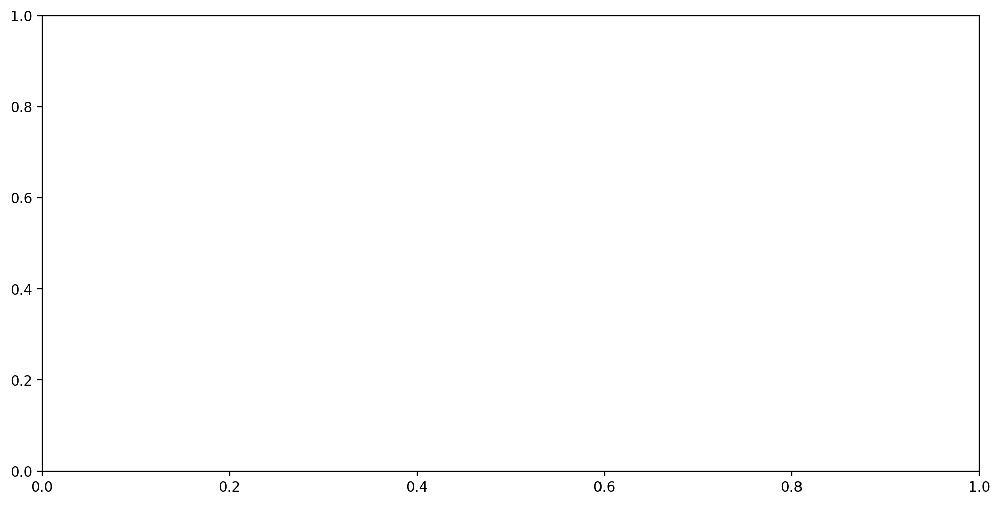

In [10]:
regions = {
    'india' : ([70,90, 5,25], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b') , ("o", 'b'), ("", 'g'), 'g', '', 'India'),
    'india_cptp' : ([70,90, 25,30], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b') , ("o", 'b'), ("", 'g'), '', 'fu', 'Northern India'),
    #'cptp' : ([70,115,25,40], 'blue', 'dashed', 2, ('o', 'k')),
    'china' : ([105,115,25,40], 'k', 'solid', 0.8, ("^", 'g') , ("", 'b') , ("o", 'b'), ("", 'g'), 'h', 'fu', 'China'),
    'australia' : ([120,140,-23, -11], 'k', 'solid', 0.8, ('', 'k'), ("v", 'b') , ("", 'b'), ("", 'g'), 'i', '', 'Australia'),
    'sa' : ([20,35, -35,-15], 'k', 'solid', 0.8, ('', 'k'), ("v", 'b'),  ("", 'b'), ("P", 'g'), 'f' , 'fu', 'South Africa'),
    'GPlains' : ([-100,-90,32,47], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("", 'b') , ("X", 'g'), 'c', 'fu', 'GPlains'), 
#     'sub_ssa_p' : ([-68,-47, -40, -20.5], 'purple', 'solid', 1.5, ('', 'k'), ("v", 'b') ,  ("", 'b'), ("X", 'b'), 'e', 'fu'),
#     'trop_ssa_p' : ([-75, -50, -20, -5], 'purple', 'solid', 1.5, ('', 'g'), ("v", 'b'), ("", 'b') , ("X", 'g'), 'd', 'fu'),
    'sub_ssa' : ([-68,-47, -40, -20.5], 'k', 'solid', 0.8, ('', 'k'), ("v", 'b') ,  ("", 'b'), ("X", 'b'), 'b', 'fu', 'ST South America'),
   # 'trop_ssa' : ([-79, -50, -20, -5], 'k', 'solid', 0.8, ('', 'g'), ("v", 'b'), ("", 'b') , ("X", 'g'), 'a', 'fu', 'Tropical South America'),
    'sahel' : ([-18.5, 25, 4, 25], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("", 'b') , ("P", 'g'), 'd', 'fu', 'West Africa'),
   # 'alps' : ([2, 15, 42.8, 48.8], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("", 'b') , ("X", 'g'), 'c', 'fu', 'Alps'),
   # 'congo' : ([9, 35, -10, 9], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("v", 'b') , ("", 'g'), 'e', 'fu', 'Central Africa')
    }


f = plt.figure(figsize=(12,6), dpi=200)
ax1 = f.add_subplot(111)
# make a map of the same size as the image (no country borders)



sm = Map(g.grid, factor=1)
# Change the country borders
sm.set_shapefile()
sm.set_shapefile(countries=True, color='grey', linewidths=0.05)

# Change the lon-lat countour setting
sm.set_lonlat_contours()
sm.set_lonlat_contours( interval=20, linewidths=0.5,
                         linestyles='dashed', colors='grey')

sm.set_rgb(ggl_img)  # add the background rgb image
sm.set_scale_bar(location=(0.88, 0.94))  # add scale
if tag == 'terrain':
    ec = 'k'
else:
    ec = 'w'
for reg in regions.keys():
        #sm.set_geometry()
        coord = (regions[reg])[0]
        #ipdb.set_trace()
        geom = shpg.box(coord[0], coord[2], coord[1], coord[3])

        edc = (regions[reg])[1]
            
            
        futag = (regions[reg])[9]
        if futag=='fu':
            ec = 'w'
        else:
            ec = 'w'
        sm.set_geometry(geom, zorder=99, facecolor=None,edgecolor=edc, linewidth=(regions[reg])[3], linestyle=(regions[reg])[2], alpha=0.1) 
        
        x, y = sm.grid.transform(coord[0]+0.5, coord[3]-2)
        plt.text(x,y,(regions[reg])[10],  color='white', fontsize=8) #fontweight='bold',
        

sm.visualize()  # plot it
plt.tight_layout()
#f.savefig('/home/ck/DIR/cornkle/figs/GLOBAL_MCS/regions_plot_'+tag+'_names.jpg')

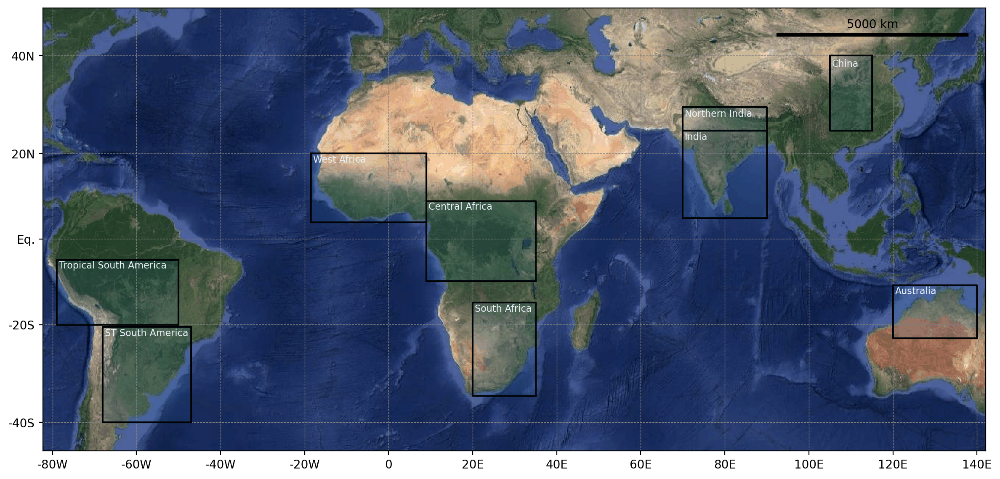

In [19]:
regions = {
    'india' : ([70,90, 5,25], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b') , ("o", 'b'), ("", 'g'), 'g', '', 'India'),
    'india_cptp' : ([70,90, 25,30], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b') , ("o", 'b'), ("", 'g'), '', 'fu', 'Northern India'),
    #'cptp' : ([70,115,25,40], 'blue', 'dashed', 2, ('o', 'k')),
    'china' : ([105,115,25,40], 'k', 'solid', 0.8, ("^", 'g') , ("", 'b') , ("o", 'b'), ("", 'g'), 'h', 'fu', 'China'),
    'australia' : ([120,140,-23, -11], 'k', 'solid', 0.8, ('', 'k'), ("v", 'b') , ("", 'b'), ("", 'g'), 'i', '', 'Australia'),
    'sa' : ([20,35, -35,-15], 'k', 'solid', 0.8, ('', 'k'), ("v", 'b'),  ("", 'b'), ("P", 'g'), 'f' , 'fu', 'South Africa'),
#     'sub_ssa_p' : ([-68,-47, -40, -20.5], 'purple', 'solid', 1.5, ('', 'k'), ("v", 'b') ,  ("", 'b'), ("X", 'b'), 'e', 'fu'),
#     'trop_ssa_p' : ([-75, -50, -20, -5], 'purple', 'solid', 1.5, ('', 'g'), ("v", 'b'), ("", 'b') , ("X", 'g'), 'd', 'fu'),
    'sub_ssa' : ([-68,-47, -40, -20.5], 'k', 'solid', 0.8, ('', 'k'), ("v", 'b') ,  ("", 'b'), ("X", 'b'), 'b', 'fu', 'ST South America'),
    'trop_ssa' : ([-79, -50, -20, -5], 'k', 'solid', 0.8, ('', 'g'), ("v", 'b'), ("", 'b') , ("X", 'g'), 'a', 'fu', 'Tropical South America'),
    'sahel' : ([-18.5, 9, 4, 20], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("", 'b') , ("P", 'g'), 'd', 'fu', 'West Africa'),
   # 'alps' : ([2, 15, 42.8, 48.8], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("", 'b') , ("X", 'g'), 'c', 'fu', 'Alps'),
    'congo' : ([9, 35, -10, 9], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("v", 'b') , ("", 'g'), 'e', 'fu', 'Central Africa')
    }


f = plt.figure(figsize=(12,6), dpi=200)
ax1 = f.add_subplot(111)
# make a map of the same size as the image (no country borders)



sm = Map(g.grid, factor=1)
# Change the country borders
sm.set_shapefile()
sm.set_shapefile(countries=True, color='grey', linewidths=0.05)

# Change the lon-lat countour setting
sm.set_lonlat_contours()
sm.set_lonlat_contours( interval=20, linewidths=0.5,
                         linestyles='dashed', colors='grey')

sm.set_rgb(ggl_img)  # add the background rgb image
sm.set_scale_bar(location=(0.88, 0.94))  # add scale
if tag == 'terrain':
    ec = 'k'
else:
    ec = 'w'
for reg in regions.keys():
        #sm.set_geometry()
        coord = (regions[reg])[0]
        #ipdb.set_trace()
        geom = shpg.box(coord[0], coord[2], coord[1], coord[3])
#         if (reg == 'india_cptp') | (reg=='china'):
#             edc = 'orange'
#         else:
        edc = (regions[reg])[1]
            
            
        futag = (regions[reg])[9]
        if futag=='fu':
            ec = 'w'
        else:
            ec = 'w'
        sm.set_geometry(geom, zorder=99, facecolor=None,edgecolor=edc, linewidth=(regions[reg])[3], linestyle=(regions[reg])[2], alpha=0.1) 
        
        x, y = sm.grid.transform(coord[0]+0.5, coord[3]-2)
        plt.text(x,y,(regions[reg])[10],  color='white', fontsize=8) #fontweight='bold',

#         points = (regions[reg])[4]
#         x, y = sm.grid.transform(coord[0]+2, coord[3]-2)
#         plt.scatter(x, y, color=points[1],marker=points[0], s=25, edgecolor=ec, linewidth=0.2)
        
#         points = (regions[reg])[5]
#         x, y = sm.grid.transform(coord[0]+3, coord[3]-2)
#         plt.scatter(x, y, color=points[1],marker=points[0], s=25, edgecolor=ec, linewidth=0.2)
        
#         points = (regions[reg])[6]
#         x, y = sm.grid.transform(coord[0]+4.5, coord[3]-2)
#         plt.scatter(x, y, color=points[1],marker=points[0], s=25, edgecolor=ec, linewidth=0.2)
        
#         points = (regions[reg])[7]
#         x, y = sm.grid.transform(coord[0]+6.5, coord[3]-2)
#         plt.scatter(x, y, color=points[1],marker=points[0], s=25, edgecolor=ec, linewidth=0.2)

   
# boxed = shpg.box(60, -35, 102, -11)
# sm.set_geometry(boxed, facecolor='white',edgecolor='white', color='white', fill=True, zorder=98)
        
# lon,lat = 63, -12.5
# x, y = sm.grid.transform(lon, lat)
# plt.plot(x,y,color='k', marker='^', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'DYAMOND Summer (40 days global)', fontsize=7, zorder=99)

# lon,lat = 63, -16
# x, y = sm.grid.transform(lon, lat)
# plt.plot(x,y,color='k', marker='v', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'DYAMOND Winter (40 days global)', fontsize=7, zorder=99)

# lon,lat = 63, -19.5
# x, y = sm.grid.transform(lon, lat)
# plt.plot(x,y,color='k', marker='o', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'CPTP (2-10 years), future planned', fontsize=7, zorder=99, color='orange')

# lon,lat = 63, -23
# x, y = sm.grid.transform(lon, lat)
# plt.plot(x,y,color='k', marker='x', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'WRF / MAR (IGE,UGA), future planned', fontsize=7, zorder=99)

# lon,lat = 63, -26.5
# x, y = sm.grid.transform(lon, lat)
# plt.plot(x,y,color='k', marker='P', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'MetUM CP4, future available', fontsize=7, zorder=99, color='k')

# lon,lat = 63, -30
# x, y = sm.grid.transform(lon, lat)
# #plt.plot(x,y,color='k', marker='x', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'Available', fontsize=7, zorder=99, color='g')

# lon,lat = 63, -33.5
# x, y = sm.grid.transform(lon, lat)
# #plt.plot(x,y,color='k', marker='x', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'To be produced or in production', fontsize=7, zorder=99, color='b')

# lon,lat = 63, -37
# x, y = sm.grid.transform(lon, lat)
# #plt.plot(x,y,color='k', marker='x', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'Future projections planned / available', fontsize=7, zorder=99, color='orange')


sm.visualize()  # plot it
plt.tight_layout()
f.savefig('/media/ck/Elements/CNRS/presentation/CNRS/CNRS_regions_plot_'+tag+'.jpg')

In [37]:
tag = 'satellite'
g = GoogleVisibleMap(x=[-90, 140], y=[-40, 30], #[-80, 140], y=[-40, 30]
                     scale=2,  # scale is for more details
                     maptype=tag)  # try out also: 'terrain'

Text(0.5, 1.0, 'Google static map')

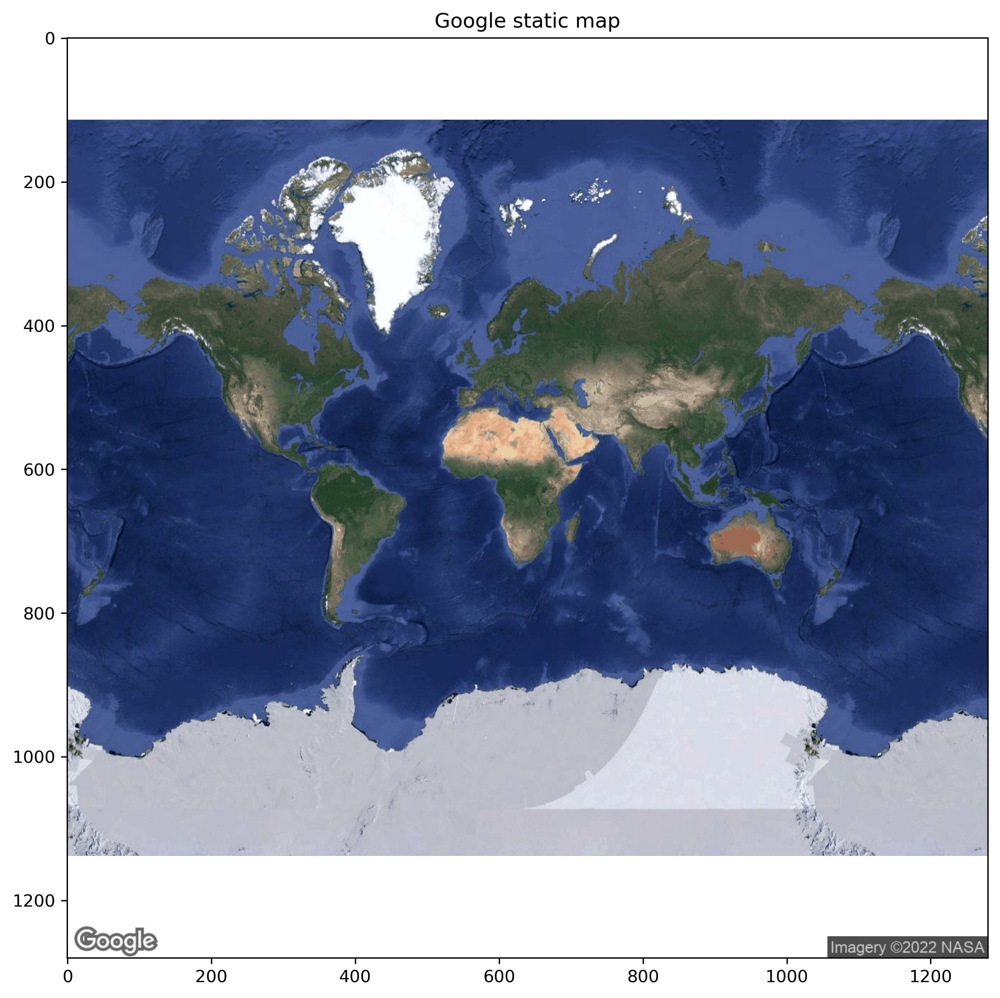

In [38]:
f = plt.figure(figsize=(15,10), dpi=300)
ax1 = f.add_subplot(111)
# the google static image is a standard rgb image
ggl_img = g.get_vardata()
ax1.imshow(ggl_img)

ax1.set_title('Google static map')


In [39]:
g.set_subset(corners=[(-105,-45),(142,50)])
ggl_img = g.get_vardata()

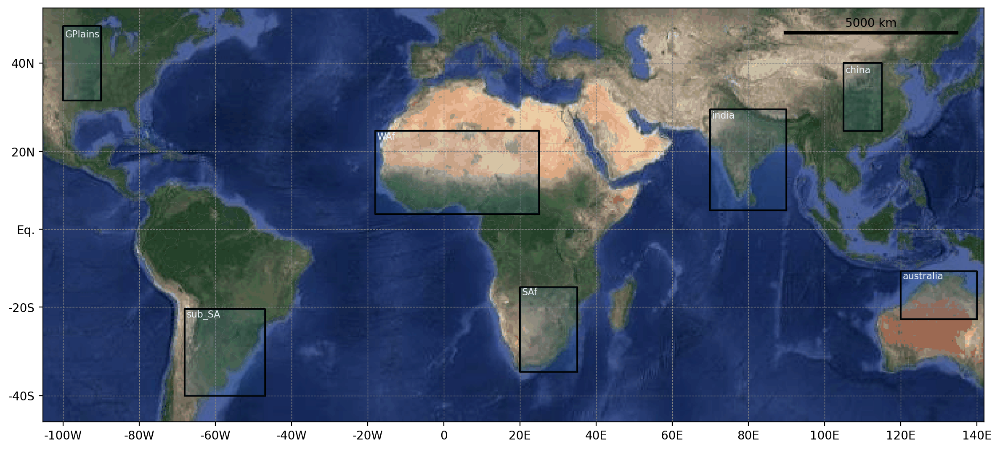

In [41]:
regions = {
    'india' : ([70,90, 5,30], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b') , ("o", 'b'), ("", 'g'), 'g', '', 'india'),
    #'india_cptp' : ([70,90, 25,30], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b') , ("o", 'b'), ("", 'g'), '', 'fu', 'Northern India'),
    #'cptp' : ([70,115,25,40], 'blue', 'dashed', 2, ('o', 'k')),
    'china' : ([105,115,25,40], 'k', 'solid', 0.8, ("^", 'g') , ("", 'b') , ("o", 'b'), ("", 'g'), 'h', 'fu', 'china'),
    'australia' : ([120,140,-23, -11], 'k', 'solid', 0.8, ('', 'k'), ("v", 'b') , ("", 'b'), ("", 'g'), 'i', '', 'australia'),
    'sa' : ([20,35, -35,-15], 'k', 'solid', 0.8, ('', 'k'), ("v", 'b'),  ("", 'b'), ("P", 'g'), 'f' , 'fu', 'SAf'),
#     'sub_ssa_p' : ([-68,-47, -40, -20.5], 'purple', 'solid', 1.5, ('', 'k'), ("v", 'b') ,  ("", 'b'), ("X", 'b'), 'e', 'fu'),
#     'trop_ssa_p' : ([-75, -50, -20, -5], 'purple', 'solid', 1.5, ('', 'g'), ("v", 'b'), ("", 'b') , ("X", 'g'), 'd', 'fu'),
    'sub_ssa' : ([-68,-47, -40, -20.5], 'k', 'solid', 0.8, ('', 'k'), ("v", 'b') ,  ("", 'b'), ("X", 'b'), 'b', 'fu', 'sub_SA'),
   # 'trop_ssa' : ([-75, -50, -20, -5], 'k', 'solid', 0.8, ('', 'g'), ("v", 'b'), ("", 'b') , ("X", 'g'), 'a', 'fu', 'Tropical South America'),
    'sahel' : ([-18,25,4,25], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("", 'b') , ("P", 'g'), 'd', 'fu', 'WAf'),
    'GPlains' : ([-100,-90,32,47], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("", 'b') , ("X", 'g'), 'c', 'fu', 'GPlains'),
  #  'congo' : ([9, 35, -10, 9], 'k', 'solid', 0.8, ("^", 'g'), ("", 'b'), ("v", 'b') , ("", 'g'), 'e', 'fu', 'Central Africa')
    }


f = plt.figure(figsize=(12,6), dpi=200)
ax1 = f.add_subplot(111)
# make a map of the same size as the image (no country borders)



sm = Map(g.grid, factor=1)
# Change the country borders
sm.set_shapefile()
sm.set_shapefile(countries=True, color='grey', linewidths=0.05)

# Change the lon-lat countour setting
sm.set_lonlat_contours()
sm.set_lonlat_contours( interval=20, linewidths=0.5,
                         linestyles='dashed', colors='grey')

sm.set_rgb(ggl_img)  # add the background rgb image
sm.set_scale_bar(location=(0.88, 0.94))  # add scale
if tag == 'terrain':
    ec = 'k'
else:
    ec = 'w'
for reg in regions.keys():
        #sm.set_geometry()
        coord = (regions[reg])[0]
        #ipdb.set_trace()
        geom = shpg.box(coord[0], coord[2], coord[1], coord[3])
#         if (reg == 'india_cptp') | (reg=='china'):
#             edc = 'orange'
#         else:
        edc = (regions[reg])[1]
            
            
        futag = (regions[reg])[9]
        if futag=='fu':
            ec = 'w'
        else:
            ec = 'w'
        sm.set_geometry(geom, zorder=99, facecolor=None,edgecolor=edc, linewidth=(regions[reg])[3], linestyle=(regions[reg])[2], alpha=0.1) 
        
        x, y = sm.grid.transform(coord[0]+0.5, coord[3]-2)
        plt.text(x,y,(regions[reg])[10],  color='white', fontsize=8) #fontweight='bold',

#         points = (regions[reg])[4]
#         x, y = sm.grid.transform(coord[0]+2, coord[3]-2)
#         plt.scatter(x, y, color=points[1],marker=points[0], s=25, edgecolor=ec, linewidth=0.2)
        
#         points = (regions[reg])[5]
#         x, y = sm.grid.transform(coord[0]+3, coord[3]-2)
#         plt.scatter(x, y, color=points[1],marker=points[0], s=25, edgecolor=ec, linewidth=0.2)
        
#         points = (regions[reg])[6]
#         x, y = sm.grid.transform(coord[0]+4.5, coord[3]-2)
#         plt.scatter(x, y, color=points[1],marker=points[0], s=25, edgecolor=ec, linewidth=0.2)
        
#         points = (regions[reg])[7]
#         x, y = sm.grid.transform(coord[0]+6.5, coord[3]-2)
#         plt.scatter(x, y, color=points[1],marker=points[0], s=25, edgecolor=ec, linewidth=0.2)

   
# boxed = shpg.box(60, -35, 102, -11)
# sm.set_geometry(boxed, facecolor='white',edgecolor='white', color='white', fill=True, zorder=98)
        
# lon,lat = 63, -12.5
# x, y = sm.grid.transform(lon, lat)
# plt.plot(x,y,color='k', marker='^', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'DYAMOND Summer (40 days global)', fontsize=7, zorder=99)

# lon,lat = 63, -16
# x, y = sm.grid.transform(lon, lat)
# plt.plot(x,y,color='k', marker='v', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'DYAMOND Winter (40 days global)', fontsize=7, zorder=99)

# lon,lat = 63, -19.5
# x, y = sm.grid.transform(lon, lat)
# plt.plot(x,y,color='k', marker='o', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'CPTP (2-10 years), future planned', fontsize=7, zorder=99, color='orange')

# lon,lat = 63, -23
# x, y = sm.grid.transform(lon, lat)
# plt.plot(x,y,color='k', marker='x', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'WRF / MAR (IGE,UGA), future planned', fontsize=7, zorder=99)

# lon,lat = 63, -26.5
# x, y = sm.grid.transform(lon, lat)
# plt.plot(x,y,color='k', marker='P', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'MetUM CP4, future available', fontsize=7, zorder=99, color='k')

# lon,lat = 63, -30
# x, y = sm.grid.transform(lon, lat)
# #plt.plot(x,y,color='k', marker='x', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'Available', fontsize=7, zorder=99, color='g')

# lon,lat = 63, -33.5
# x, y = sm.grid.transform(lon, lat)
# #plt.plot(x,y,color='k', marker='x', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'To be produced or in production', fontsize=7, zorder=99, color='b')

# lon,lat = 63, -37
# x, y = sm.grid.transform(lon, lat)
# #plt.plot(x,y,color='k', marker='x', zorder=99)
# x, y = sm.grid.transform(lon+1.5, lat-1)
# plt.text(x+2, y-2.5, 'Future projections planned / available', fontsize=7, zorder=99, color='orange')


sm.visualize()  # plot it
plt.tight_layout()
f.savefig('/home/ck/DIR/cornkle/figs/GLOBAL_MCS/MCS_regions_plot_'+tag+'.jpg')